In [1]:
# !pip install -q imagecodecs
!pip install -q geotiff
!pip install -q rasterio
!pip install -q imageio
!pip install -q matplotlib==3.9.0
!pip install -q umap_learn
!pip install -q torch_geometric
!pip install -q quantum-evolution-kernel
!pip install -q torch-cluster -f https://pytorch-geometric.com/whl/torch-2.5.1+cu121.html

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 185.8/185.8 kB 6.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.6/8.6 MB 73.4 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.2/22.2 MB 65.8 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.3/8.3 MB 65.0 MB/s eta 0:00:00:00:0100:01
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
mlxtend 0.23.3 requires scikit-learn>=1.3.1, but you have scikit-learn 1.2.2 which is incompatible.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.8/88.8 kB 3.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.9/56.9 kB 3.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.1/63.1 kB 401.8 kB/s eta 0:00:000:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 22.1 MB/s eta 0:00:0000:01
     ━━━━━━

In [2]:
import os
import numpy as np
from matplotlib import pyplot as plt
import rasterio
import rasterio.plot
from tqdm.notebook import tqdm

# Data loading and visualization 

In [3]:
fire_path = "/kaggle/input/wildfirespreadts/2018/fire_21890058/"
sorted(os.listdir(fire_path))

['2018-07-12.tif',
 '2018-07-13.tif',
 '2018-07-14.tif',
 '2018-07-15.tif',
 '2018-07-16.tif',
 '2018-07-17.tif',
 '2018-07-18.tif',
 '2018-07-19.tif',
 '2018-07-20.tif',
 '2018-07-21.tif',
 '2018-07-22.tif',
 '2018-07-23.tif',
 '2018-07-24.tif',
 '2018-07-25.tif']

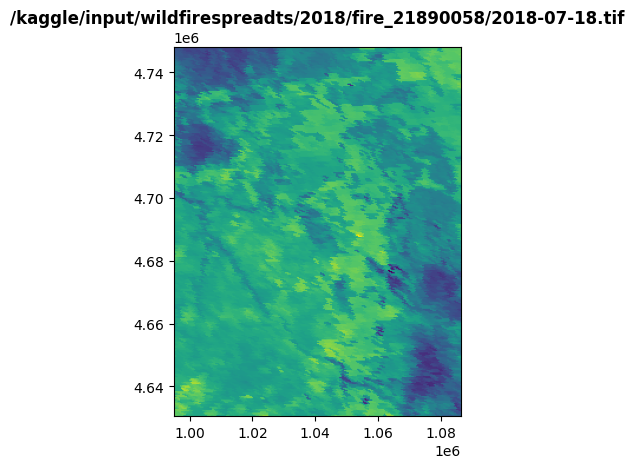

In [4]:
image_path = "/kaggle/input/wildfirespreadts/2018/fire_21890058/2018-07-18.tif"
tiff = rasterio.open(image_path)
rasterio.plot.show(tiff, title = image_path)
plt.show()

In [5]:
img = tiff.read(tiff.indexes)

In [6]:
labels = list(tiff.descriptions)
print(labels)

['M11', 'I2', 'I1', 'NDVI_last', 'EVI2_last', 'total precipitation', 'wind speed', 'wind direction', 'minimum temperature', 'maximum temperature', 'energy release component', 'specific humidity', 'slope', 'aspect', 'elevation', 'pdsi', 'LC_Type1', 'total_precipitation_surface_sum', 'forecast wind speed', 'forecast wind direction', 'forecast temperature', 'forecast specific humidity', 'active fire']


<ipython-input-7-eb0a36b5c327>:3: RuntimeWarning: invalid value encountered in cast
  im = np.expand_dims(img[idx],-1).astype(int)


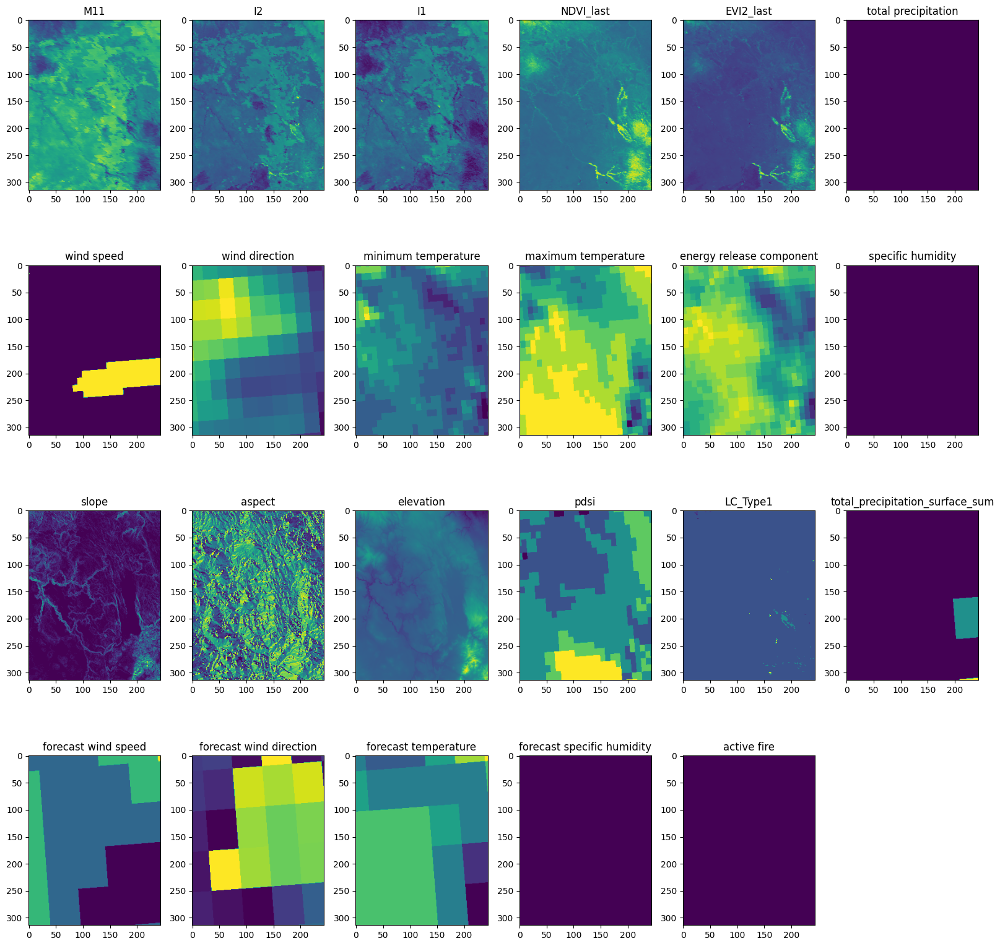

In [7]:
fig, axs = plt.subplots(4,6, figsize=(16,16))
for idx, (ax, label) in enumerate(zip(axs.flatten(), tiff.descriptions)):
  im = np.expand_dims(img[idx],-1).astype(int)
  ax.imshow(im)
  ax.set_title(label)
axs.flatten()[-1].remove()
plt.tight_layout()
plt.show()

In [8]:
def read_tiff_file(file_path):
  tiff = rasterio.open(file_path)
  img = tiff.read(tiff.indexes)
  labels = tiff.descriptions
  return tiff, img, labels

def plot_tiff(img, labels, title = ''):
  fig, axs = plt.subplots(4,6, figsize=(16,16))
  for idx, (ax, label) in enumerate(zip(axs.flatten(), labels)):
    im = np.expand_dims(img[idx],-1).astype(int)
    ax.imshow(im)
    ax.set_title(label)
  axs.flatten()[-1].remove()
  plt.suptitle(title)
  plt.tight_layout()
  plt.show()

<ipython-input-8-8437c39a2206>:10: RuntimeWarning: invalid value encountered in cast
  im = np.expand_dims(img[idx],-1).astype(int)


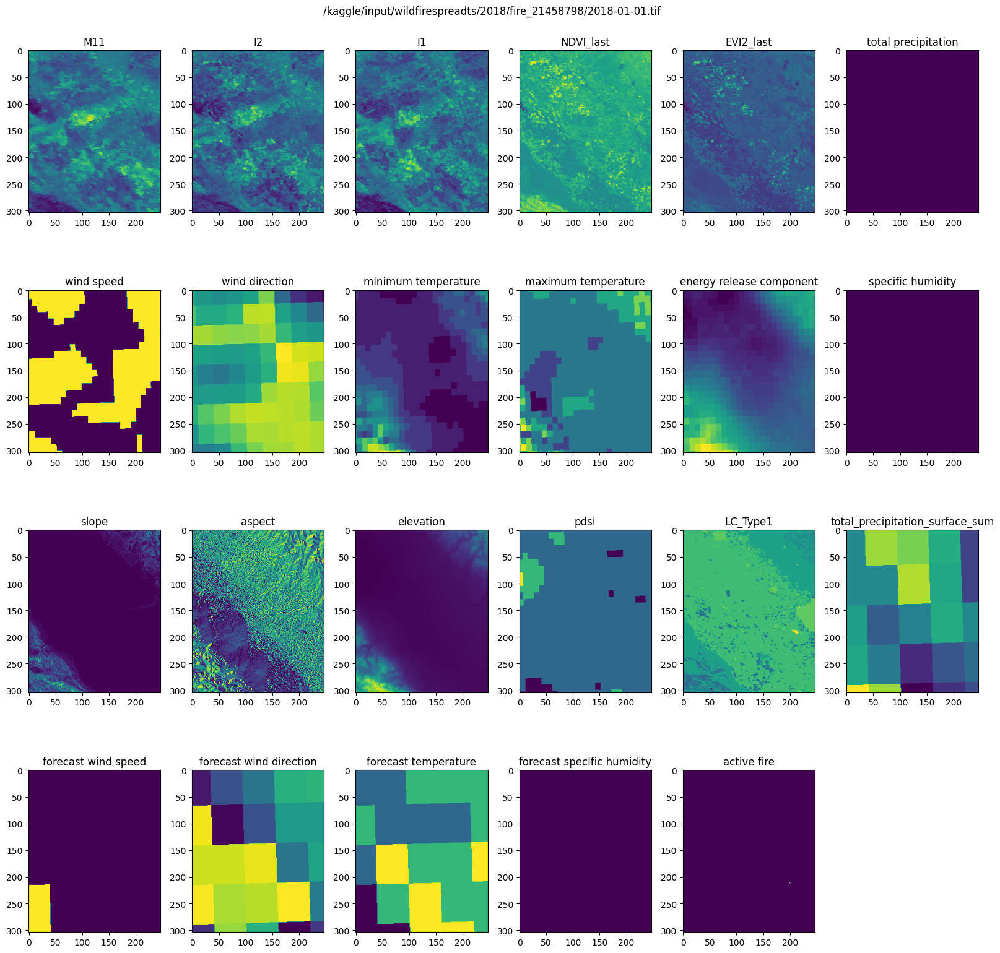

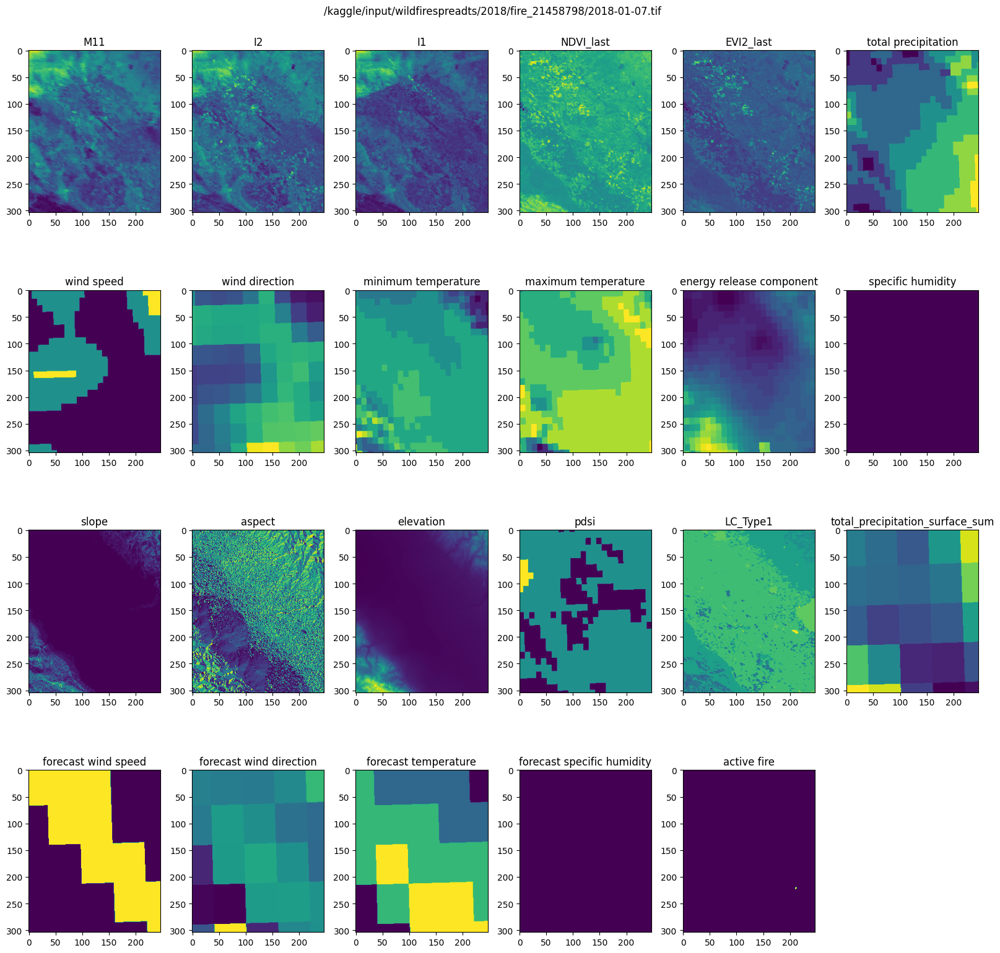

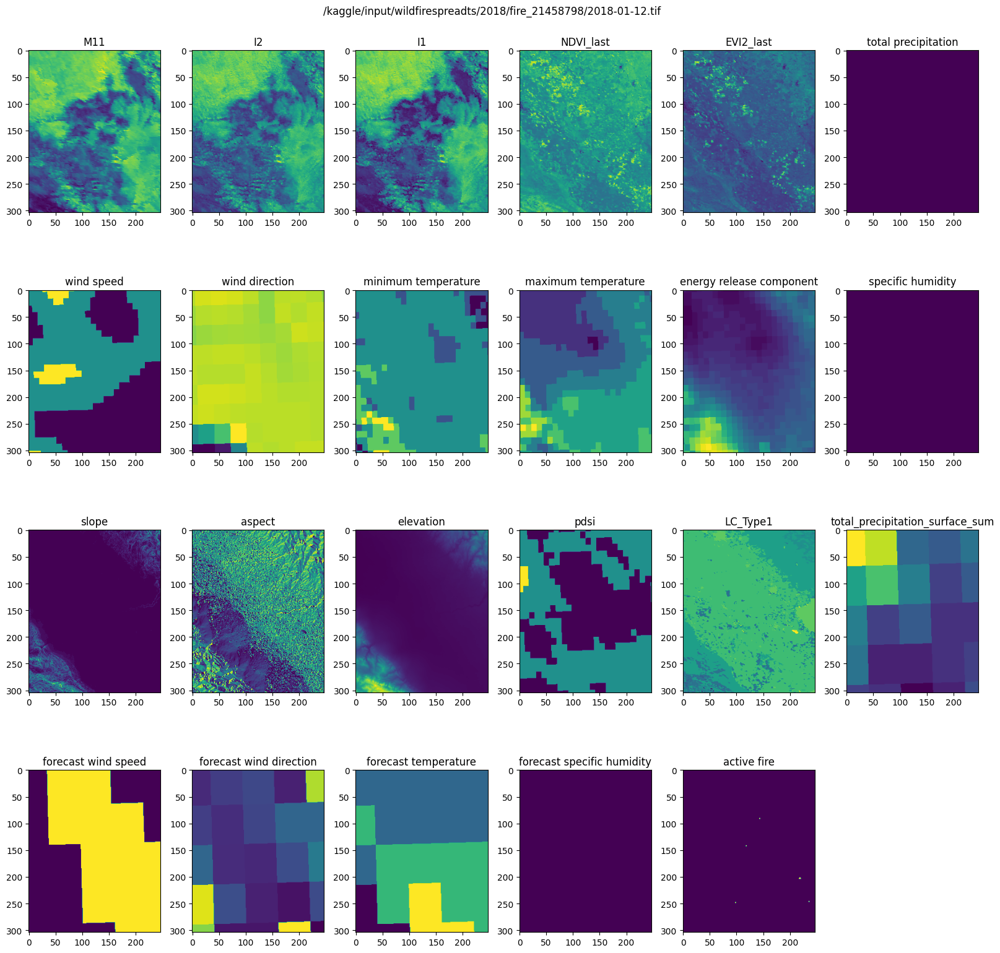

In [9]:
fire_path = '/kaggle/input/wildfirespreadts/2018/fire_21458798'
for file in os.listdir(fire_path)[:3]:
  full_file_path = os.path.join(fire_path,file)
  tiff, img, labels = read_tiff_file(full_file_path)
  plot_tiff(img,labels, title = full_file_path)


In [10]:
from joblib import Parallel, delayed
import os
import numpy as np
from tqdm import tqdm

def process_fire(fire_path):
    for f in os.listdir(fire_path):
        tiff, img, labels = read_tiff_file(os.path.join(fire_path,f))
        if not np.isnan(img[-1]).all():
            return fire_path
    return None

def comb_fires(dataset_path = "/kaggle/input/wildfirespreadts"):
    results = {year:[] for year in sorted(os.listdir(dataset_path))}
    
    for year in sorted(os.listdir(dataset_path)):
        year_fires = os.path.join(dataset_path, year)
        print(year)
        
        fire_paths = [os.path.join(year_fires, fire) for fire in os.listdir(year_fires)]
        
        year_results = Parallel(n_jobs=-1)(
            delayed(process_fire)(fire_path) for fire_path in tqdm(fire_paths, position=0)
        )
        results[year] = year_results
        
    return results
    
active_fires = comb_fires()

2018


100%|██████████| 176/176 [00:12<00:00, 14.10it/s]


2019


100%|██████████| 74/74 [00:03<00:00, 19.88it/s]


2020


100%|██████████| 201/201 [00:12<00:00, 16.40it/s]


2021


100%|██████████| 156/156 [00:07<00:00, 20.28it/s]


In [11]:
num_fires = {year : len(os.listdir(f'/kaggle/input/wildfirespreadts/{year}')) for year in os.listdir("/kaggle/input/wildfirespreadts")}
num_active_fires = {year : len(active_fires[year]) for year in active_fires.keys()}
print("Number of fires: ", num_fires)
print("Number of active fires: ", num_active_fires)

Number of fires:  {'2020': 201, '2019': 74, '2021': 156, '2018': 176}
Number of active fires:  {'2018': 176, '2019': 74, '2020': 201, '2021': 156}


GIF saved to gifs/2018_fire_21999299.gif


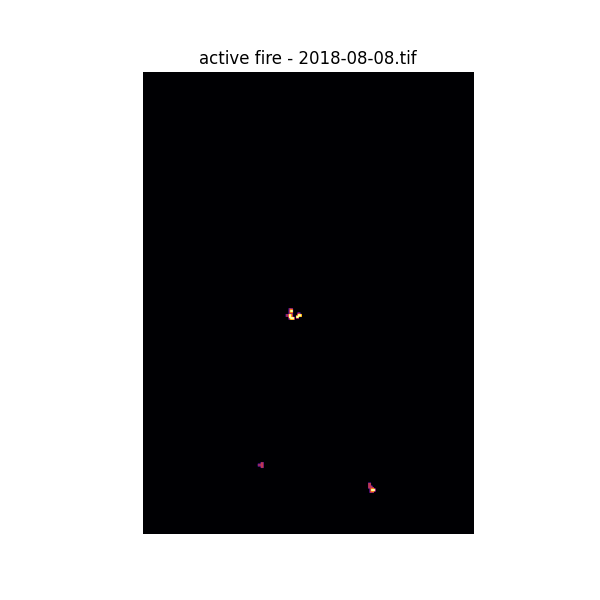

In [12]:
import imageio
import rasterio
import os
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import Image, display

def create_band_gif(folder_path, band_idx, label, output_gif='output.gif', duration=0.5, background_value = 15):
    """
    Creates and displays a GIF from all TIFF files in a folder for a specific band.
    
    Args:
        folder_path (str): Path to the folder containing TIFF files.
        band_idx (int): Index of the band to use.
        label (str): Label for the GIF frames.
        output_gif (str): Output path for the GIF.
        duration (float): Time between frames in seconds.
    """
    images = []
    tiff_files = [f for f in os.listdir(folder_path) if f.endswith('.tif') or f.endswith('.tiff')]

    for file in sorted(tiff_files):
        file_path = os.path.join(folder_path, file)
        tiff, img, labels = read_tiff_file(file_path)
        
        if band_idx >= img.shape[0]:
            print(f"Band index {band_idx} out of range for file {file}")
            continue
        
        # Extract the specific band
        band_img = img[band_idx]
        band_img[np.isnan(band_img)] = background_value
        # print(band_img.min(), band_img.max())
        # Plot the band
        fig, ax = plt.subplots(figsize=(6,6))
        ax.imshow(band_img, cmap='inferno')
        ax.set_title(f"{label} - {file}")
        ax.axis('off')
        
        # Save plot to an image buffer
        fig.canvas.draw()
        image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
        image = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))
        images.append(image)
        plt.close(fig)
    
    # Create and save the GIF
    if images:
        imageio.mimsave(output_gif, images, duration=duration, loop=0)
        print(f"GIF saved to {output_gif}")
        
        # Display the GIF
        display(Image(filename=output_gif))
    else:
        print("No images were processed to create the GIF.")
os.makedirs('gifs', exist_ok=True)
fire = active_fires['2018'][-1]
gif_name = '_'.join(fire.split('/')[-2:])+'.gif'
create_band_gif(fire, 22,labels[22], output_gif = f"gifs/{gif_name}")

GIF saved to gifs/2019_fire_23300669.gif


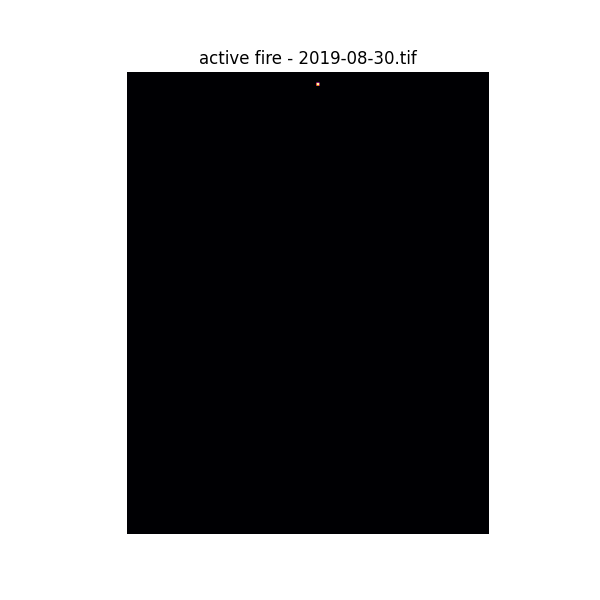

In [13]:
fire = active_fires['2019'][-1]
gif_name = '_'.join(fire.split('/')[-2:])+'.gif'
create_band_gif(fire, 22,labels[22], output_gif = f"gifs/{gif_name}")

GIF saved to gifs/2020_fire_24333000.gif


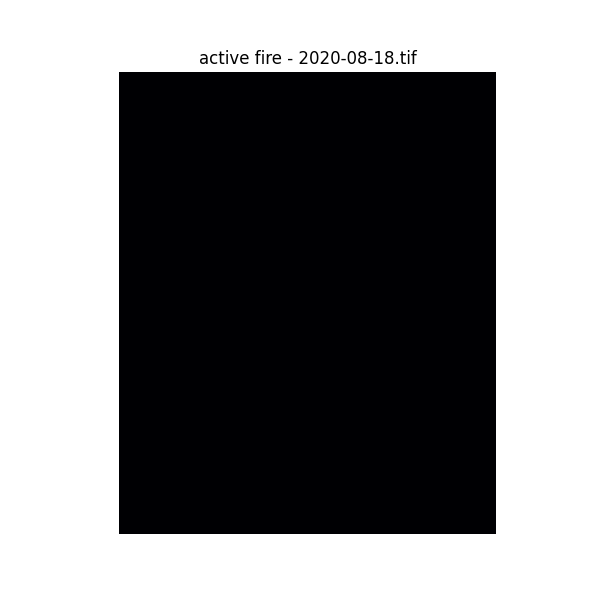

In [14]:
fire = active_fires['2020'][-1]
gif_name = '_'.join(fire.split('/')[-2:])+'.gif'
create_band_gif(fire, 22,labels[22], output_gif = f"gifs/{gif_name}")

GIF saved to gifs/2021_fire_25547912.gif


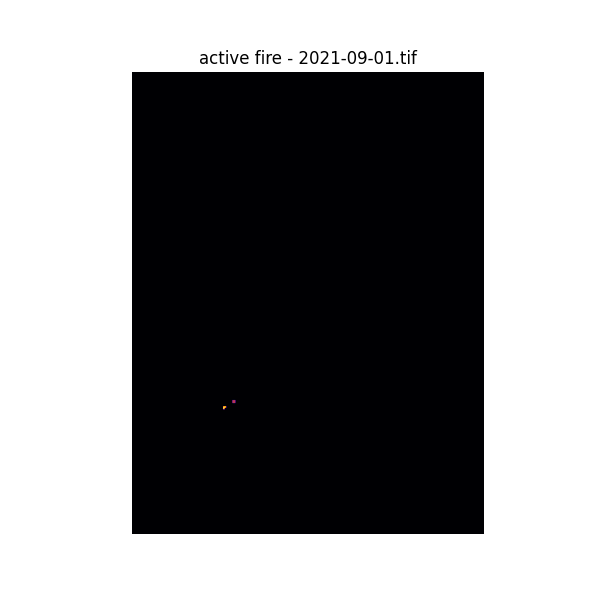

In [15]:
fire = active_fires['2021'][-1]
gif_name = '_'.join(fire.split('/')[-2:])+'.gif'
create_band_gif(fire, 22,labels[22], output_gif = f"gifs/{gif_name}")

GIF saved to gifs/2021_fire_25547912_M11.gif


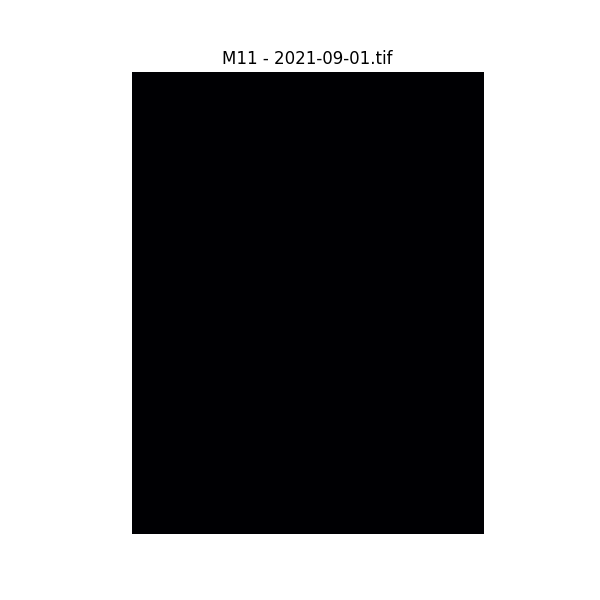

GIF saved to gifs/2021_fire_25547912_I2.gif


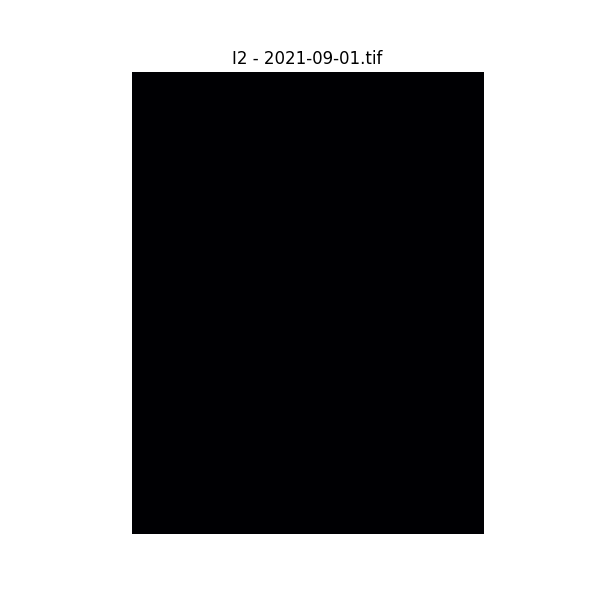

GIF saved to gifs/2021_fire_25547912_I1.gif


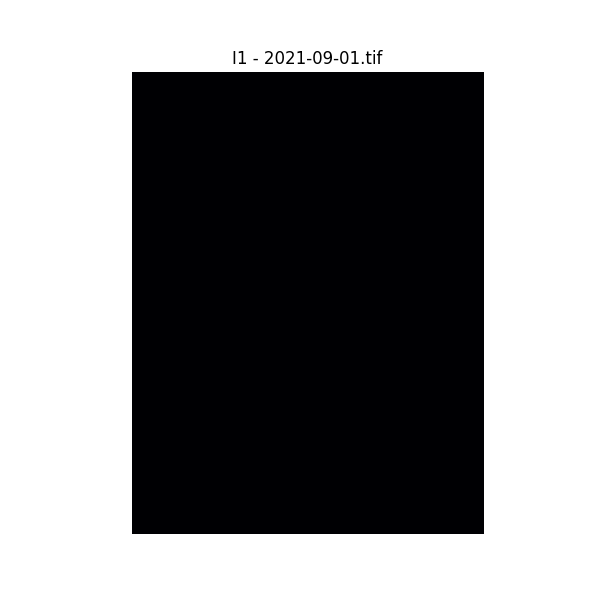

GIF saved to gifs/2021_fire_25547912_NDVI_last.gif


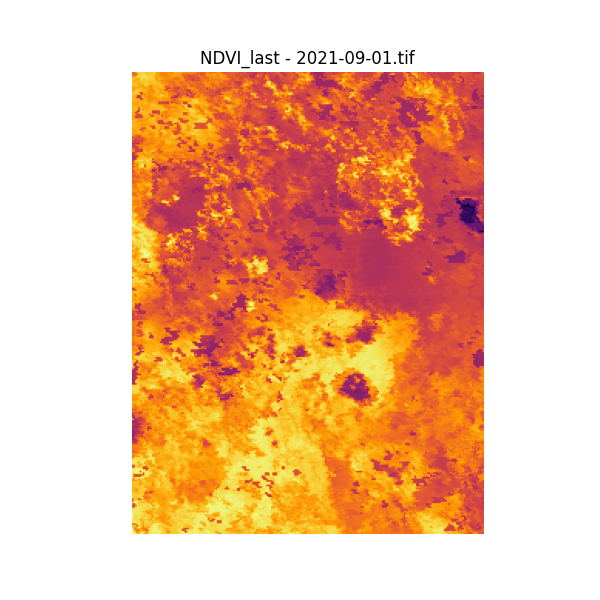

GIF saved to gifs/2021_fire_25547912_EVI2_last.gif


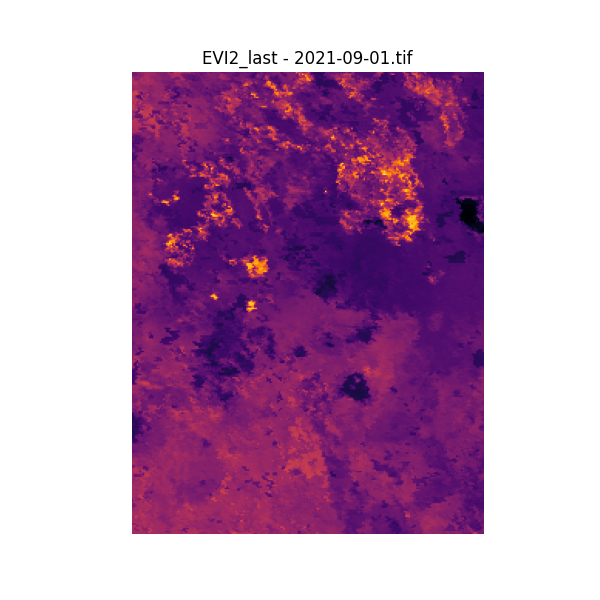

GIF saved to gifs/2021_fire_25547912_total precipitation.gif


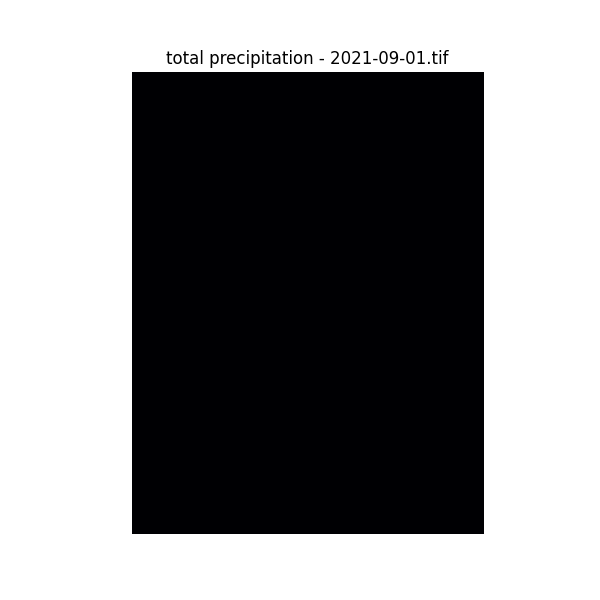

GIF saved to gifs/2021_fire_25547912_wind speed.gif


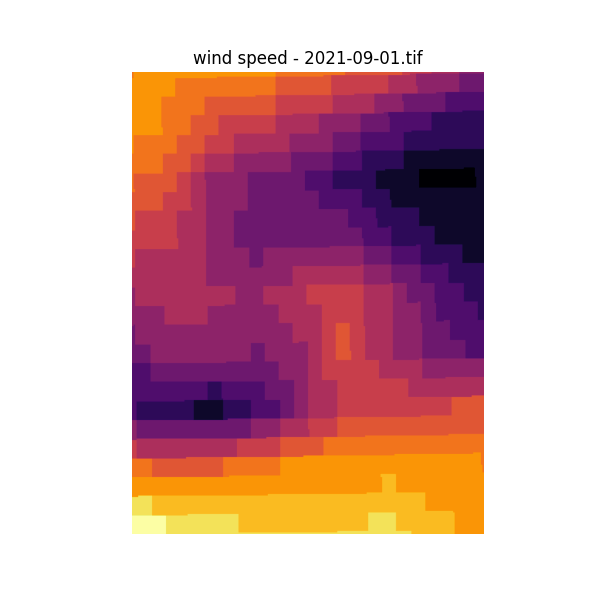

GIF saved to gifs/2021_fire_25547912_wind direction.gif


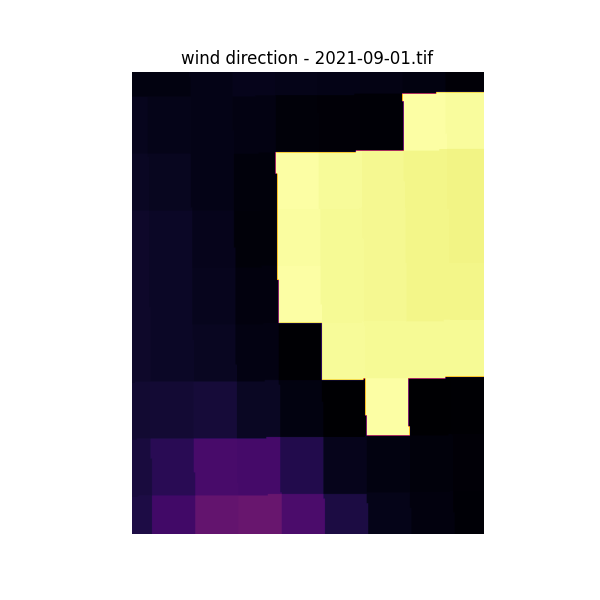

GIF saved to gifs/2021_fire_25547912_minimum temperature.gif


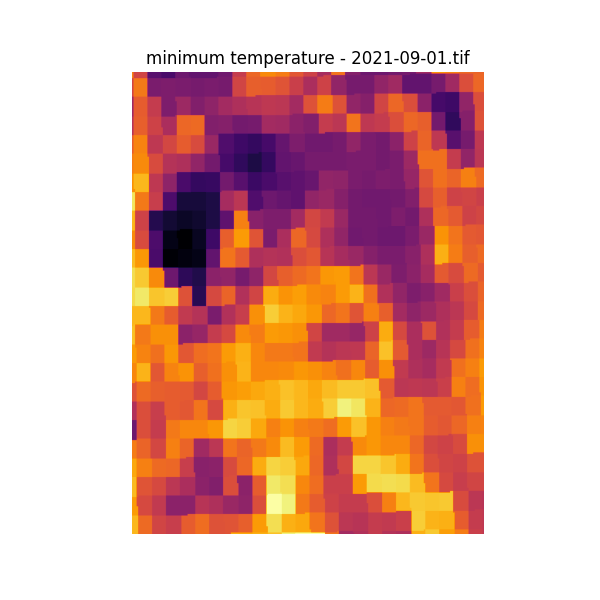

GIF saved to gifs/2021_fire_25547912_maximum temperature.gif


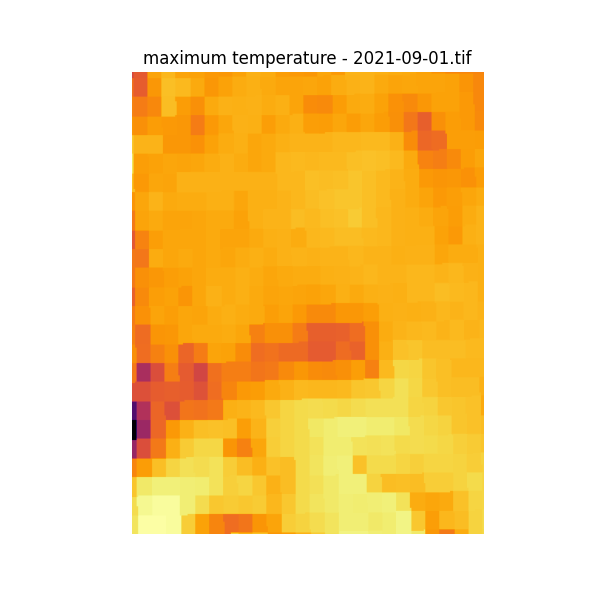

GIF saved to gifs/2021_fire_25547912_energy release component.gif


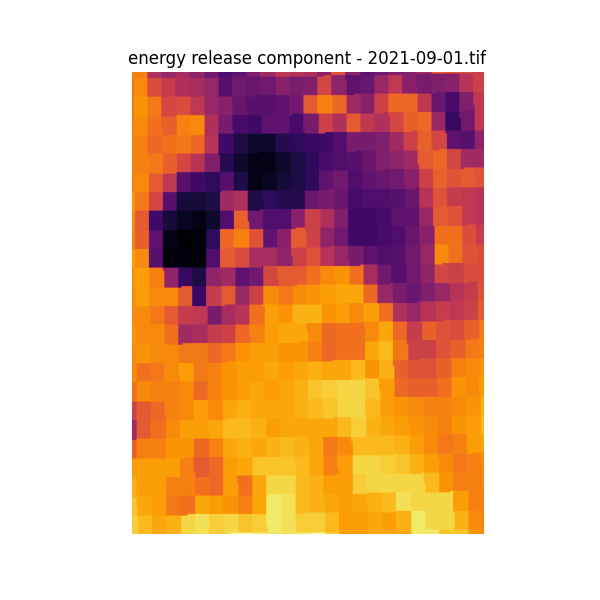

GIF saved to gifs/2021_fire_25547912_specific humidity.gif


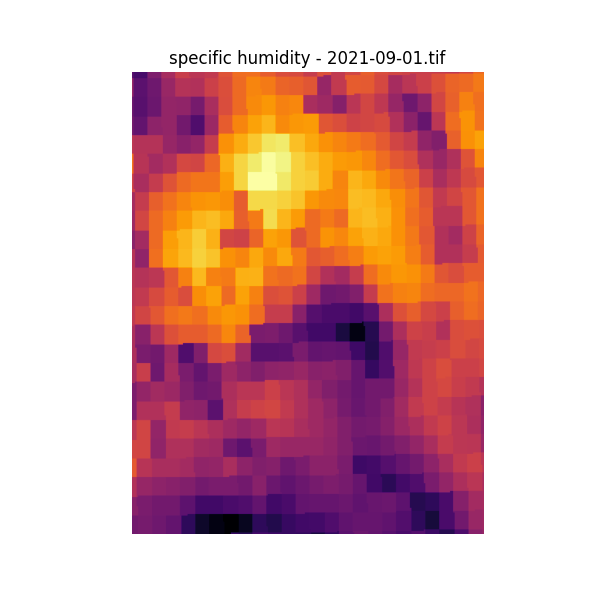

GIF saved to gifs/2021_fire_25547912_slope.gif


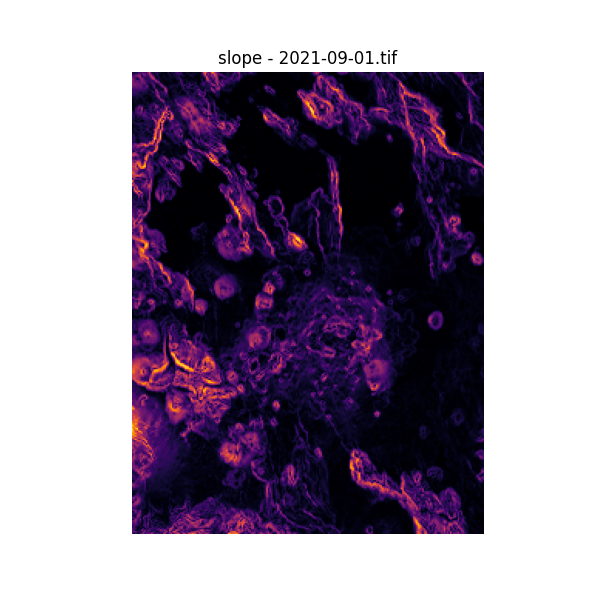

GIF saved to gifs/2021_fire_25547912_aspect.gif


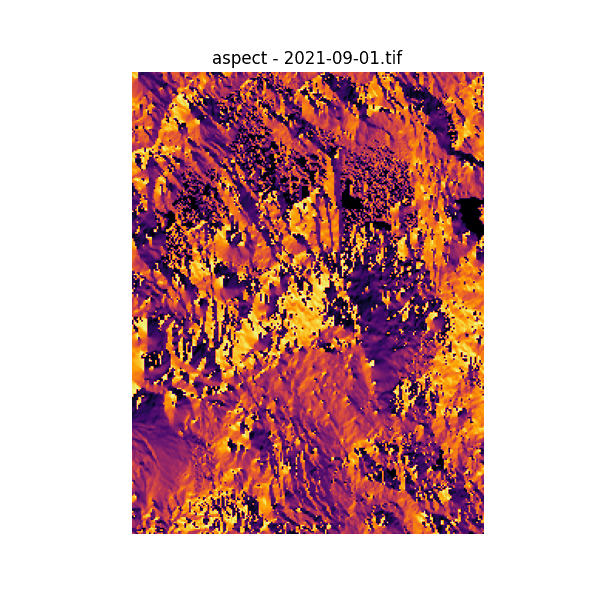

GIF saved to gifs/2021_fire_25547912_elevation.gif


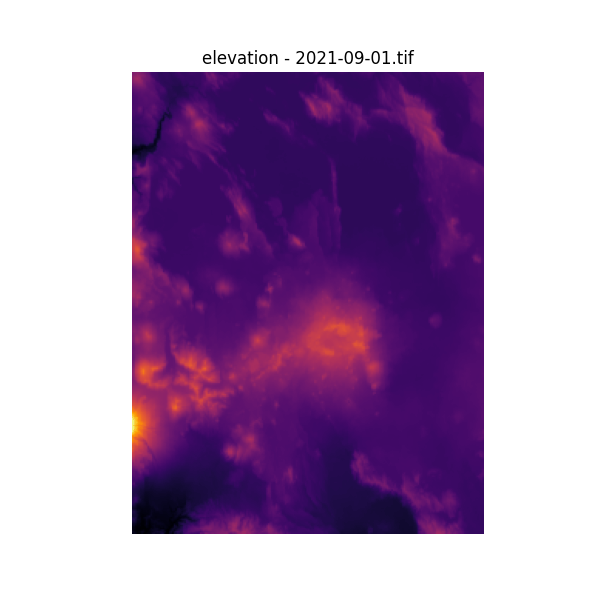

GIF saved to gifs/2021_fire_25547912_pdsi.gif


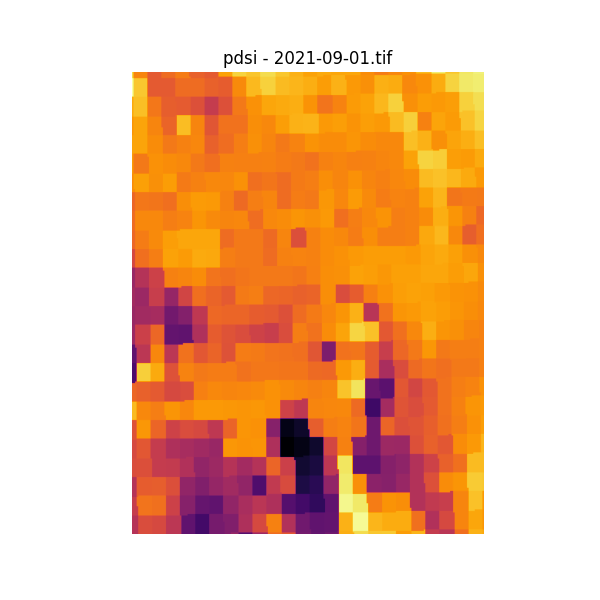

GIF saved to gifs/2021_fire_25547912_LC_Type1.gif


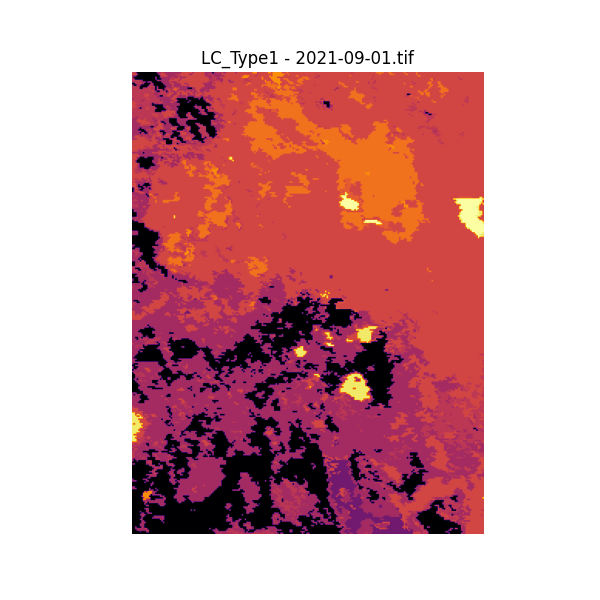

GIF saved to gifs/2021_fire_25547912_total_precipitation_surface_sum.gif


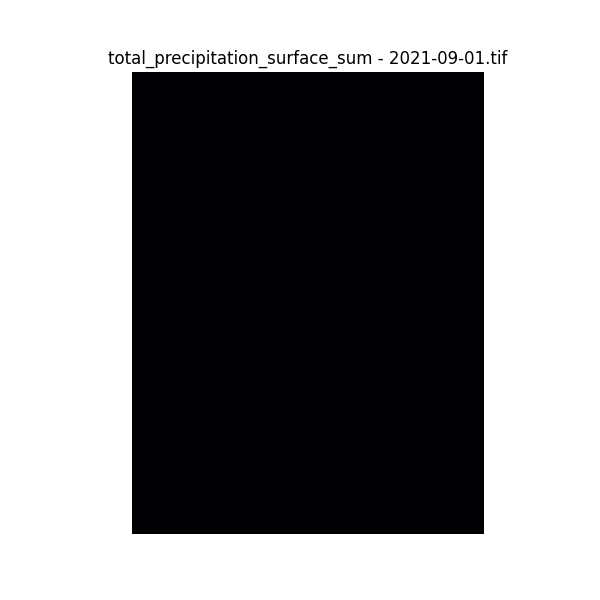

GIF saved to gifs/2021_fire_25547912_forecast wind speed.gif


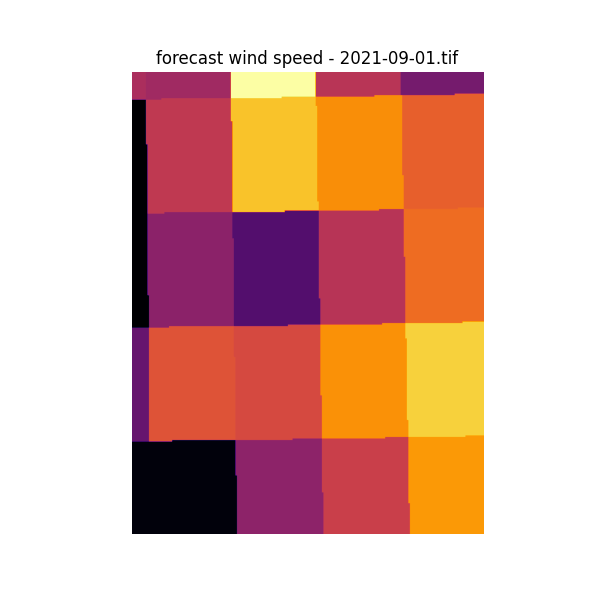

GIF saved to gifs/2021_fire_25547912_forecast wind direction.gif


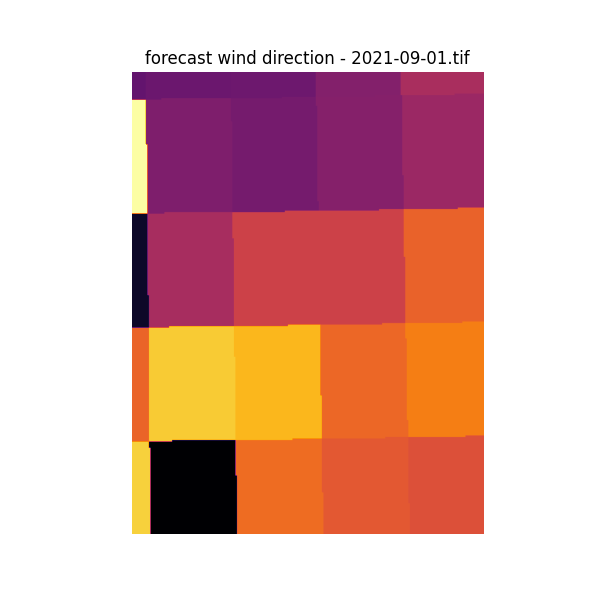

GIF saved to gifs/2021_fire_25547912_forecast temperature.gif


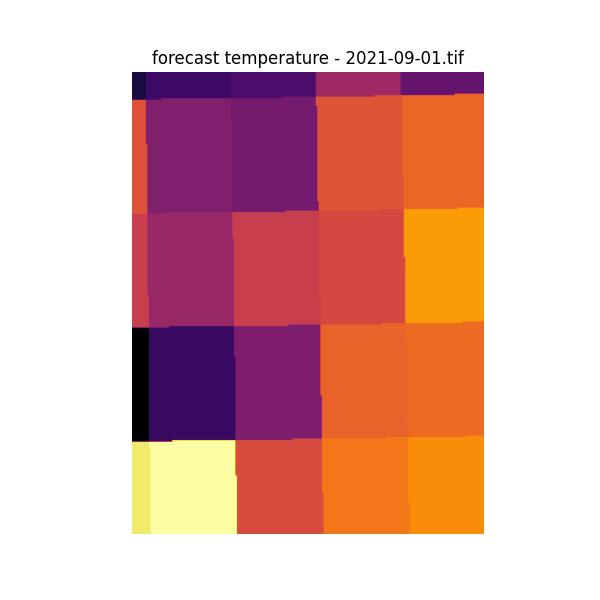

GIF saved to gifs/2021_fire_25547912_forecast specific humidity.gif


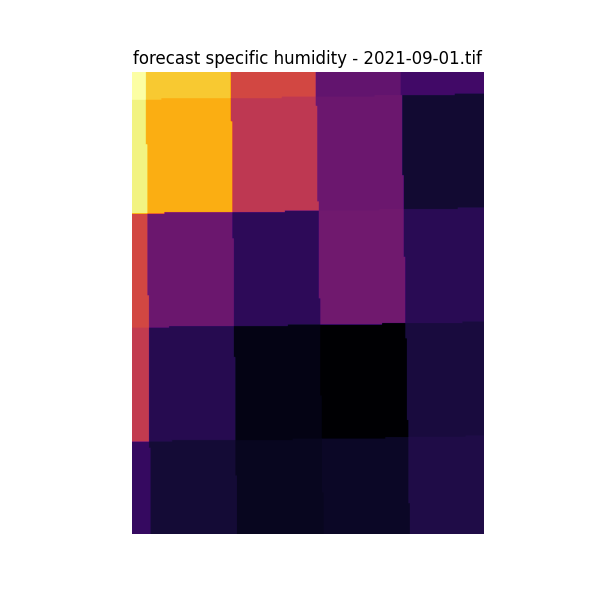

GIF saved to gifs/2021_fire_25547912_active fire.gif


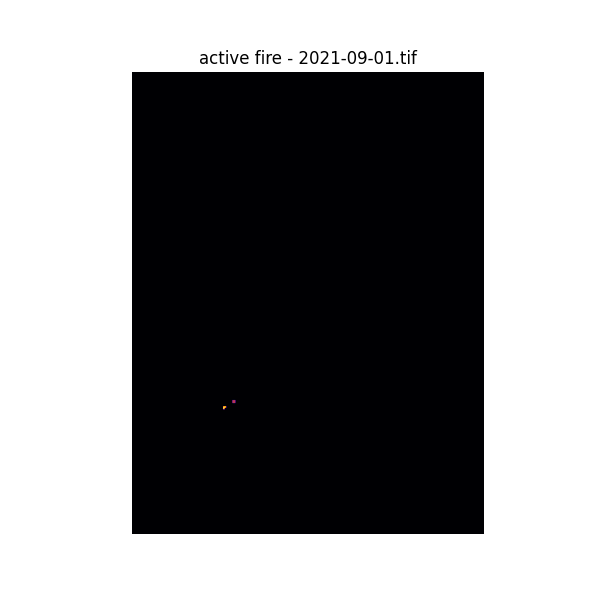

In [16]:
fire = active_fires['2021'][-1]

for idx, label in enumerate(labels): 
    gif_name = '_'.join(fire.split('/')[-2:])+f'_{label}.gif'
    create_band_gif(fire, idx, label, output_gif = f"gifs/{gif_name}")

In [17]:
def read_tiff_file(file_path):
  tiff = rasterio.open(file_path)
  img = tiff.read(tiff.indexes)
  labels = tiff.descriptions
  return tiff, img, labels

In [18]:
import torch
fire = os.path.join(active_fires['2021'][-1], os.listdir(active_fires['2021'][-1])[0])
tiff, img, labels = read_tiff_file(fire)
img.shape

(23, 300, 228)

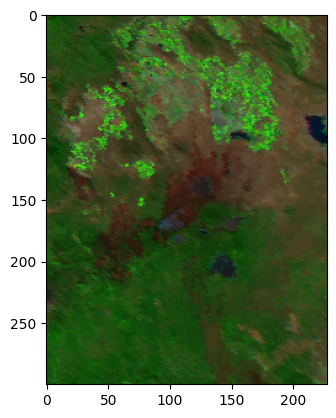

(300, 228, 3)

In [19]:
import cv2
fire = os.path.join(active_fires['2021'][-1], os.listdir(active_fires['2021'][-1])[0])
tiff, img, labels = read_tiff_file(fire)
img.shape
img=img[:3,:,:]
img=np.transpose(img,(1,2,0))
normalized_image = cv2.normalize(
    img, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX).astype(np.uint8)
fire = img[-1,:,:]
normalized_fire = cv2.normalize(
    fire, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX).astype(np.uint8)
plt.imshow(normalized_image)
plt.show()
img.shape

# Spliting image into grid

Felzenszwalb number of segments: 177
SLIC number of segments: 203
Quickshift number of segments: 574
Watershed number of segments: 234


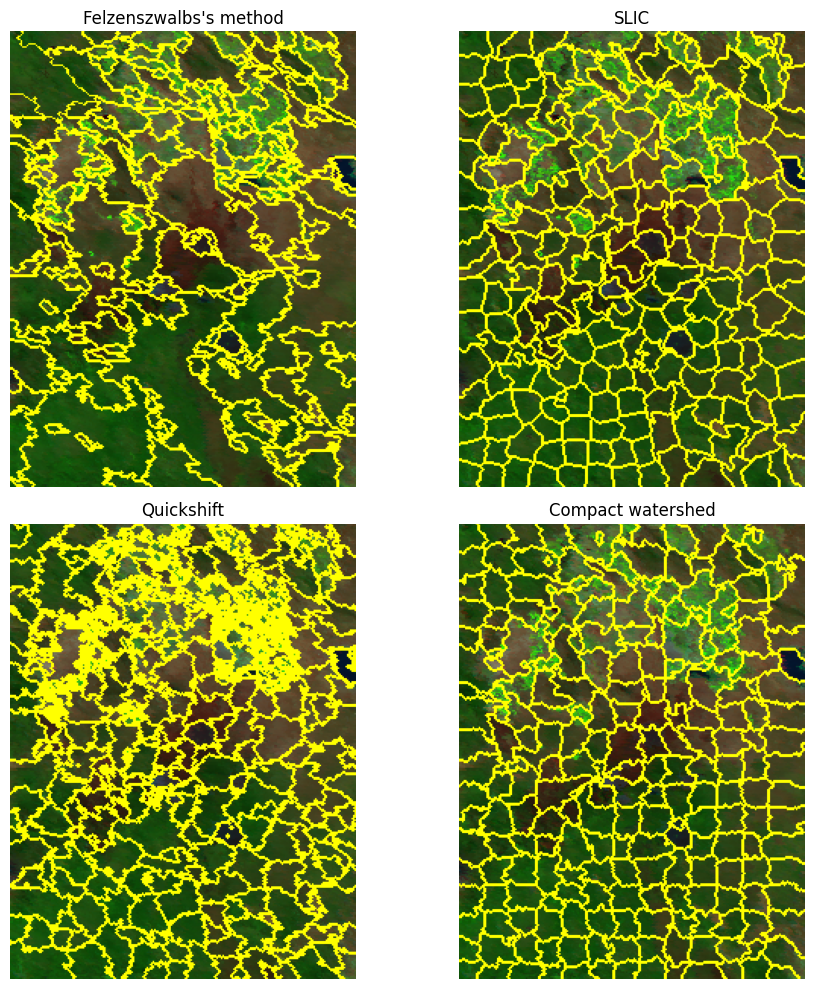

In [20]:
import matplotlib.pyplot as plt
import numpy as np
!pip install -q scikit-image
from skimage.data import astronaut
from skimage.color import rgb2gray
from skimage.filters import sobel
from skimage.segmentation import felzenszwalb, slic, quickshift, watershed
from skimage.segmentation import mark_boundaries
from skimage.util import img_as_float
img = normalized_image

segments_fz = felzenszwalb(img, scale=100, sigma=0.5, min_size=50)
segments_slic = slic(img, n_segments=250, compactness=10, sigma=1, start_label=1)
segments_quick = quickshift(img, kernel_size=3, max_dist=6, ratio=0.5)
gradient = sobel(rgb2gray(img))
segments_watershed = watershed(gradient, markers=250, compactness=0.001)

print(f'Felzenszwalb number of segments: {len(np.unique(segments_fz))}')
print(f'SLIC number of segments: {len(np.unique(segments_slic))}')
print(f'Quickshift number of segments: {len(np.unique(segments_quick))}')
print(f'Watershed number of segments: {len(np.unique(segments_watershed))}')

fig, ax = plt.subplots(2, 2, figsize=(10, 10), sharex=True, sharey=True)

ax[0, 0].imshow(mark_boundaries(img, segments_fz))
ax[0, 0].set_title("Felzenszwalbs's method")
ax[0, 1].imshow(mark_boundaries(img, segments_slic))
ax[0, 1].set_title('SLIC')
ax[1, 0].imshow(mark_boundaries(img, segments_quick))
ax[1, 0].set_title('Quickshift')
ax[1, 1].imshow(mark_boundaries(img, segments_watershed))
ax[1, 1].set_title('Compact watershed')

for a in ax.ravel():
    a.set_axis_off()

plt.tight_layout()
plt.show()

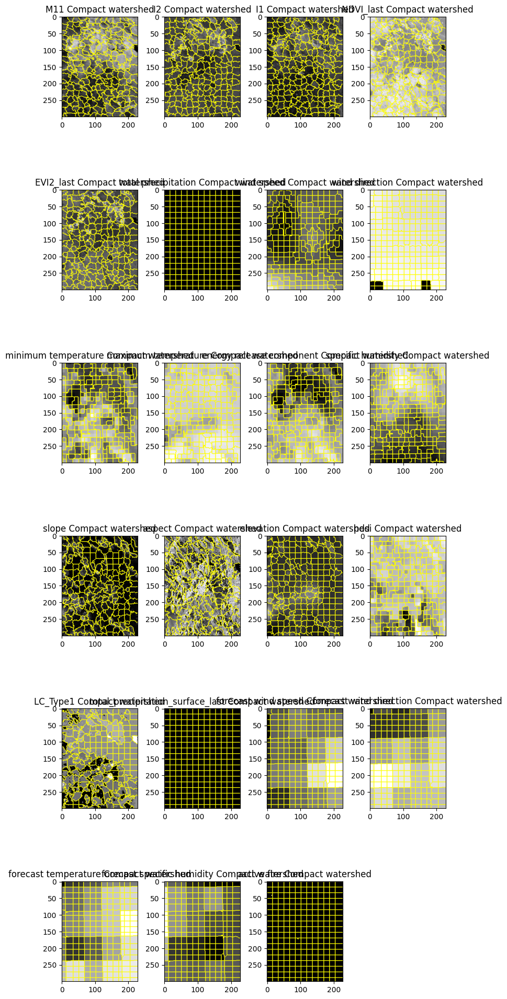

In [21]:
fire = os.path.join(active_fires['2021'][-1], os.listdir(active_fires['2021'][-1])[0])
tiff, hs_img, labels = read_tiff_file(fire)
# hs_img.shape
fig, axs = plt.subplots(6,4, figsize=(8,20))
for channel, ax, label in zip(range(hs_img.shape[0]),axs.flatten(), labels):
    img = hs_img[channel]
    img = np.expand_dims(img,-1)
    img=np.concatenate([img,img,img],axis=2)
    img[np.isnan(img)]=0
    normalized_image = cv2.normalize(
        img, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX).astype(np.uint8)
    
    gradient = sobel(rgb2gray(normalized_image))
    segments_watershed = watershed(gradient, markers=250, compactness=0.001)
    ax.imshow(mark_boundaries(normalized_image, segments_watershed))
    ax.set_title(f'{label} Compact watershed')
axs[-1][-1].remove()
plt.tight_layout()
plt.show()

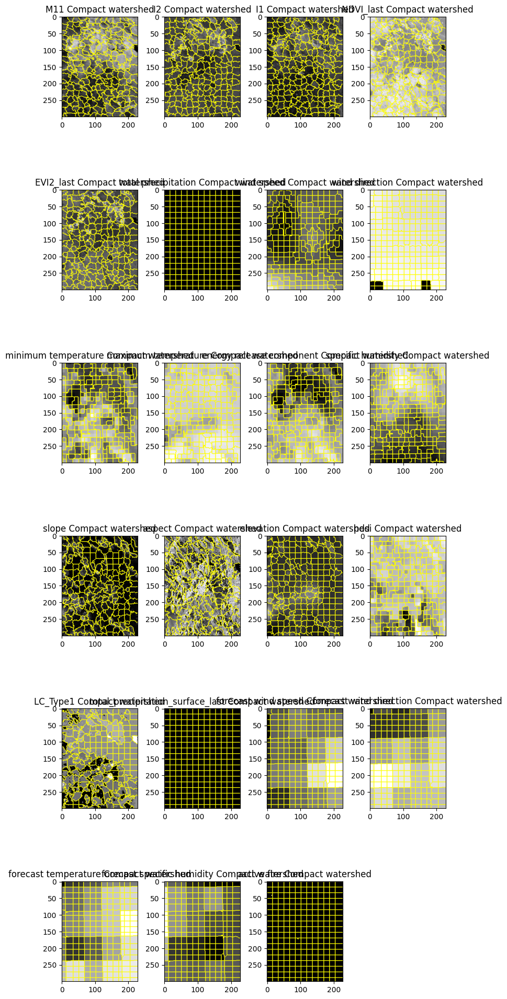

In [22]:
fire = os.path.join(active_fires['2021'][-1], os.listdir(active_fires['2021'][-1])[0])
tiff, hs_img, labels = read_tiff_file(fire)
# hs_img.shape
fig, axs = plt.subplots(6,4, figsize=(8,20))
for channel, ax, label in zip(range(hs_img.shape[0]),axs.flatten(), labels):
    img = hs_img[channel]
    img = np.expand_dims(img,-1)
    img=np.concatenate([img,img,img],axis=2)
    img[np.isnan(img)]=0
    normalized_image = cv2.normalize(
        img, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX).astype(np.uint8)
    
    gradient = sobel(rgb2gray(normalized_image))
    segments_watershed = watershed(gradient, markers=250, compactness=0.001)
    ax.imshow(mark_boundaries(normalized_image, segments_watershed))
    ax.set_title(f'{label} Compact watershed')
axs[-1][-1].remove()
plt.tight_layout()
plt.show()

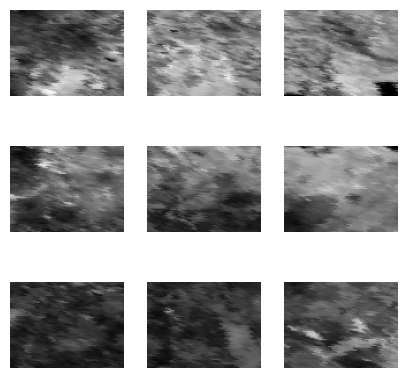

In [23]:
import matplotlib.pyplot as plt
import cv2
import numpy as np


def img_to_grid(img, row,col):
    ww = [[i.min(), i.max()] for i in np.array_split(range(img.shape[0]),row)]
    hh = [[i.min(), i.max()] for i in np.array_split(range(img.shape[1]),col)]
    w = int(np.mean([[w[1]-w[0]] for w in ww]))
    h = int(np.mean([[h[1]-h[0]] for h in hh]))
    grid = [img[j:jj,i:ii,:] for j,jj in ww for i,ii in hh]
    grid = [cv2.resize(i,(w, h)) for i in grid]
    return grid, len(ww), len(hh)

def plot_grid(grid,row,col,h=5,w=5):
    fig, ax = plt.subplots(nrows=row, ncols=col)
    [axi.set_axis_off() for axi in ax.ravel()]

    fig.set_figheight(h)
    fig.set_figwidth(w)
    c = 0
    for row in ax:
        for col in row:
            col.imshow(np.flip(grid[c],axis=-1))
            c+=1
    plt.show()

fire = os.path.join(active_fires['2021'][-1], os.listdir(active_fires['2021'][-1])[0])
tiff, hs_img, labels = read_tiff_file(fire)
row, col =3,3
img = hs_img[0]
img = np.expand_dims(img,-1)
img=np.concatenate([img,img,img],axis=2)
img[np.isnan(img)]=0
normalized_image = cv2.normalize(
    img, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX).astype(np.uint8)

grid , r,c = img_to_grid(normalized_image, row,col)
plot_grid(grid,r,c)

# Embedding extraction

In [24]:
from transformers import SiglipVisionModel, AutoProcessor
from umap import UMAP
SIGLIP_MODEL_PATH = 'google/siglip-base-patch16-224'
features_model = SiglipVisionModel.from_pretrained(SIGLIP_MODEL_PATH)
processor = AutoProcessor.from_pretrained(SIGLIP_MODEL_PATH, use_fast=True)

reducer = UMAP(n_components=3, n_neighbors=4)
inputs = processor(images=grid, return_tensors="pt")
outputs = features_model(**inputs)
embeddings = torch.mean(outputs.last_hidden_state, dim=1).detach().cpu().numpy()
reduced_embeddings = reducer.fit_transform(embeddings)

config.json:   0%|          | 0.00/432 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/813M [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/368 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/711 [00:00<?, ?B/s]

spiece.model:   0%|          | 0.00/798k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/409 [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/2.40M [00:00<?, ?B/s]

In [25]:
import torch
data = []
fire = os.path.join(active_fires['2021'][-1], os.listdir(active_fires['2021'][-1])[0])
tiff, hs_img, labels = read_tiff_file(fire)
row, col =3,3
for channel in range(len(hs_img)-1):
    img = hs_img[channel]
    img = np.expand_dims(img,-1)
    img=np.concatenate([img,img,img],axis=2)
    img[np.isnan(img)] = 0
    normalized_image = cv2.normalize(
        img, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX).astype(np.uint8)
    
    grid , r,c = img_to_grid(normalized_image, row,col)
    inputs = processor(images=grid, return_tensors="pt")
    outputs = features_model(**inputs)
    embeddings = torch.mean(outputs.last_hidden_state, dim=1).detach().cpu().numpy()
    reduced_embeddings = reducer.fit_transform(embeddings)
    data.append(reduced_embeddings)
data = torch.tensor(np.array(data))

# Graph creation

<ipython-input-26-18f0db4963c6>:10: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  node_features = torch.tensor(data.reshape(22, 27), dtype=torch.float)


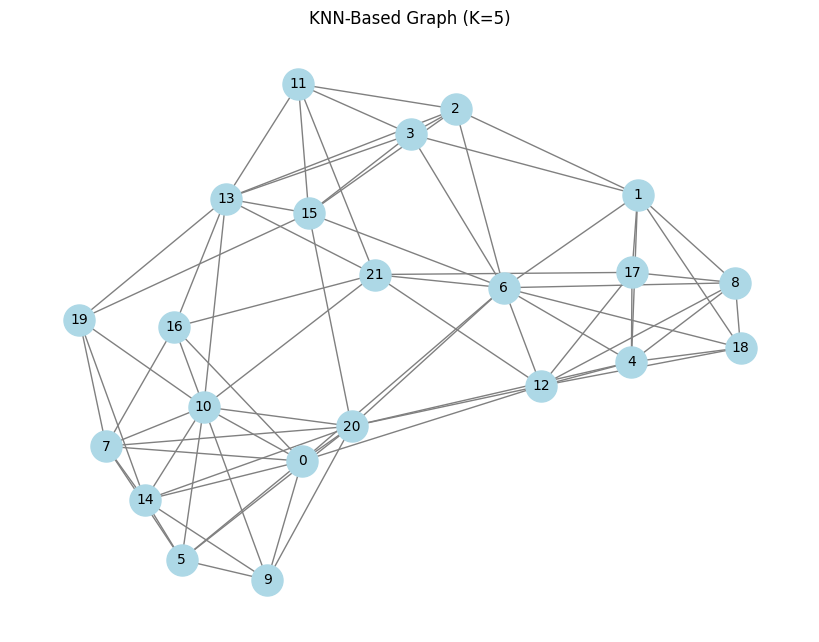

In [26]:
import torch
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
from torch_geometric.data import Data
from torch_cluster import knn_graph
from torch_geometric.utils import to_networkx

# Reshape each feature into a single 27-dimensional vector (flatten 9x3)
node_features = torch.tensor(data.reshape(22, 27), dtype=torch.float)

# Create a k-NN graph (K=5)
edge_index = knn_graph(node_features, k=5, loop=False)

# Create PyG graph
graph = Data(x=node_features, edge_index=edge_index)

# Convert to NetworkX for visualization
G = to_networkx(graph, to_undirected=True)

# Plot the graph
plt.figure(figsize=(8, 6))
nx.draw(G, with_labels=True, node_color='lightblue', edge_color='gray', node_size=500, font_size=10)
plt.title("KNN-Based Graph (K=5)")
plt.show()


# QEK ML

### Quick start guide

In [27]:
# # Load a dataset
# import torch_geometric.datasets as pyg_dataset
# import tensorflow as tf
# og_ptcfm = pyg_dataset.TUDataset(root="dataset", name="PTC_FM")

# # Setup a quantum feature extractor for this dataset.
# # In this example, we'll use QutipExtractor, to emulate a Quantum Device on our machine.
# import qek.data.graphs as qek_graphs
# import qek.data.extractors as qek_extractors
# extractor = qek_extractors.EmuMPSExtractor(compiler=qek_graphs.PTCFMCompiler())

# # Add the graphs, compile them and look at the results.
# extractor.add_graphs(graphs=og_ptcfm[:50])
# extractor.compile()

In [28]:
# processed_dataset = extractor.run().processed_data

In [29]:
# # Prepare a machine learning pipeline with Scikit Learn.
# from sklearn.model_selection import train_test_split
# from sklearn.svm import SVC

# X = [data for data in processed_dataset]  # Features
# y = [data.target for data in processed_dataset]  # Targets
# X_train, X_test, y_train, y_test = train_test_split(X, y, stratify = y, test_size=0.2, random_state=42)

# # Train a kernel
# from qek.kernel import QuantumEvolutionKernel as QEK
# kernel = QEK(mu=0.5)
# model = SVC(kernel=kernel, random_state=42)
# model.fit(X_train, y_train)

### from sklearn.preprocessing import StandardScaler

def process_single_fire(fire_path, tiff_file):
    """Optimized processing of a single fire TIFF file into a PyG Data object."""
    # Read the TIFF file
    tiff, hs_img, labels = read_tiff_file(os.path.join(fire_path, tiff_file))
    
    num_channels = len(hs_img) - 1  # Exclude fire mask
    hs_img = np.nan_to_num(hs_img)  # Replace NaNs with 0 in one step
    
    # Extract features from all channels (excluding fire mask)
    img_stack = np.repeat(hs_img[:num_channels, :, :, np.newaxis], 3, axis=-1)  # Convert all to 3-channel
    
    # Convert each channel's image to a grid and flatten
    grids = [img_to_grid(img_stack[channel], row=3, col=3)[0] for channel in range(num_channels)]
    
    # Flatten the grids into a list of images for the processor
    grid_images = [img for grid in grids for img in grid]  # Flatten list of lists
    
    # Ensure all images have the same shape
    grid_images = np.stack(grid_images, axis=0)  # Stack into a uniform array
    
    # Prepare processor inputs
    inputs = processor(images=grid_images, return_tensors="pt")
    
    # Extract embeddings (batch processing for speed)
    outputs = features_model(**inputs)
    embeddings = torch.mean(outputs.last_hidden_state, dim=1).detach().cpu().numpy()
    
    # Reduce embeddings (fit_transform once per fire)
    reduced_embeddings = reducer.fit_transform(embeddings)
    
    # Reshape embeddings into [num_channels, flattened_features]
    features = torch.tensor(reduced_embeddings.reshape(num_channels, -1), dtype=torch.float)
    
    # **Extract target (fire region mask from last channel)**
    target = torch.tensor(hs_img[-1].flatten(), dtype=torch.float)  # Flatten once

    # Create graph edges (k-NN)
    edge_index = knn_graph(features, k=5, loop=False)

    # Return PyG Data object
    return Data(x=features, edge_index=edge_index, y=target)
Our model

In [35]:
import os
import torch
import numpy as np
import cv2
from joblib import Parallel, delayed
from tqdm import tqdm
from torch_geometric.data import Data, InMemoryDataset
from torch_cluster import knn_graph
from sklearn.preprocessing import StandardScaler

def process_single_fire(fire_path, tiff_file):
    """Processes a single fire TIFF file into a PyG Data object."""
    try:
        tiff_path = os.path.join(fire_path, tiff_file)
        tiff, hs_img, labels = read_tiff_file(tiff_path)

        num_channels = len(hs_img) - 1  # Exclude fire mask
        hs_img = np.nan_to_num(hs_img)  # Replace NaNs with 0 in one step

        # Stack images into 3-channel format
        img_stack = np.repeat(hs_img[:num_channels, :, :, np.newaxis], 3, axis=-1)

        # Extract features
        features = []
        for channel in range(num_channels):
            img = img_stack[channel]
            img = cv2.normalize(img, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX).astype(np.uint8)
            grid, _, _ = img_to_grid(img, row=3, col=3)
            grid_shapes = [g.shape for g in grid]
            target_shape = max(grid_shapes, key=lambda x: x[0] * x[1])  # Max shape
            resized_grid = [cv2.resize(g, (target_shape[1], target_shape[0])) for g in grid]
            grid = np.stack(resized_grid)

            # Normalize the grid to [0, 1] range (divide by 255)
            grid = grid.astype(np.float32) / 255.0

            # Extract embeddings in batch mode
            inputs = processor(images=list(grid), return_tensors="pt")
            outputs = features_model(**inputs)
            embeddings = torch.mean(outputs.last_hidden_state, dim=1).detach().cpu().numpy()
            reduced_embeddings = reducer.fit_transform(embeddings)
            features.append(reduced_embeddings)

        features = torch.tensor(np.array(features).reshape(num_channels, -1), dtype=torch.float)

        # Extract target (fire region mask)
        target = torch.tensor(hs_img[-1].flatten(), dtype=torch.float)

        # Create graph edges (k-NN)
        edge_index = knn_graph(features, k=5, loop=False)

        return Data(x=features, edge_index=edge_index, y=target)
    
    except Exception as e:
        print(f"Error processing {tiff_file}: {e}")
        return None  # Return None if processing fails

class FireDataset(InMemoryDataset):
    def __init__(self, root, active_fires, transform=None, pre_transform=None, n_jobs=-1):
        self.active_fires = active_fires  # Dictionary of fire datasets (2018-2021)
        self.n_jobs = min(n_jobs, os.cpu_count() // 2)  # Limit jobs to avoid overloading CPU
        super(FireDataset, self).__init__(root, transform, pre_transform)

        if os.path.exists(self.processed_paths[0]):
            self.data, self.slices = torch.load(self.processed_paths[0])
        else:
            self.data, self.slices = self.process()

    @property
    def processed_file_names(self):
        return ["data.pt"]

    def process(self):
        fire_files = [
            (fire_path, tiff_file)
            for year in self.active_fires.keys()
            for fire_path in self.active_fires[year]
            for tiff_file in os.listdir(fire_path)
        ]

        print(f"Processing {len(fire_files)} fire files...")

        # **Optimized Parallel Execution**
        data_list = Parallel(n_jobs=self.n_jobs, backend="threading")(
            delayed(process_single_fire)(fire_path, tiff_file)
            for fire_path, tiff_file in tqdm(fire_files[:16], position=0, leave=True)
        )

        # Remove None values (failed cases)
        data_list = [data for data in data_list if data is not None]

        # Collate and save dataset
        data, slices = self.collate(data_list)
        torch.save((data, slices), self.processed_paths[0])
        return data, slices

# Initialize the dataset with parallel processing
dataset = FireDataset(root="fire_dataset", active_fires=active_fires, n_jobs=16)

Processing...


Processing 13607 fire files...


100%|██████████| 16/16 [10:29<00:00, 39.32s/it]
Done!
<ipython-input-35-a65294a68821>:65: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.data, self.slices = torch.load(s

In [49]:
for i in range(len(dataset)):
    dataset[i].y=torch.sum(dataset[i].y)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [50]:
dataset[0].y

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


tensor([0., 0., 0.,  ..., 0., 0., 0.])

In [44]:
import torch_geometric.datasets as pyg_dataset
import qek.data.graphs as qek_graphs
import qek.data.extractors as qek_extractors

# Setup Quantum Feature Extractor
extractor = qek_extractors.EmuMPSExtractor(compiler=qek_graphs.PTCFMCompiler())

# Add the extracted fire graphs to the quantum processor
extractor.add_graphs(graphs=dataset)

# Compile the graphs
extractor.compile()

# Run quantum feature extraction
processed_dataset = extractor.run().processed_data


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


RuntimeError: a Tensor with 65360 elements cannot be converted to Scalar

In [ ]:
# Prepare a machine learning pipeline with Scikit Learn.
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC

X = [data for data in processed_dataset]  # Features
y = [data.target for data in processed_dataset]  # Targets
X_train, X_test, y_train, y_test = train_test_split(X, y, stratify = y, test_size=0.2, random_state=42)

# Train a kernel
from qek.kernel import QuantumEvolutionKernel as QEK
kernel = QEK(mu=0.5)
model = SVC(kernel=kernel, random_state=42)
model.fit(X_train, y_train)